In [1]:
from tensorflow import keras
import tensorflow as tf
import numpy as np
import matplotlib.pylab as plt
from skimage import io
from tqdm.notebook import tqdm
from keras import layers
from multiprocessing import Pool
from functools import partial
from scipy import ndimage

def random_slice(shape, target_size=(256,256)):
    height, width=shape
    crop_x=np.random.randint(0, width-target_size[0]+1)
    crop_y=np.random.randint(0, height-target_size[1]+1)
    return slice(crop_y, crop_y+target_size[1]), slice(crop_x, crop_x+target_size[0])

def slice_data(img, window_x, window_y):
    n_blocks=np.array(img.shape)//[window_y, window_x]
    big_window_y, big_window_x=(img.shape/n_blocks).astype('int')
    window=min(big_window_y, big_window_x) # this is stupid but I don't want to think about where it's window x and where it's window y below. So square windows only

    img = img[:n_blocks[0]*window, :n_blocks[1]*window]

    output = img.reshape((-1, window, img.shape[1]//window, window))
    return np.array(output.transpose((0,2,1,3)).reshape(-1, window, window)[:, :window_x, :window_y])

def random_flip_rotate(X, y, flip=True, rotate=True):
    if flip:
        flip_img=np.random.randint(0,3,size=len(X)) # 0=no flip, 1=flip vertical, 2=flip horizontal
    else:
        flip_img=np.zeros(len(X), dtype='int')
    if rotate:
        rot_img=np.random.randint(0,4, size=len(X)) # n*90 degrees rotation ccw
    else:
        rot_img=np.zeros(len(X), dtype='int')

    transformed_X=flip_rotate(X, flip_img, rot_img)
    transformed_y=flip_rotate(y, flip_img, rot_img)

    return transformed_X, transformed_y

def flip_rotate(img_arr, flip_img, rot_img):
    #flip
    img_arr[flip_img==1]=np.flip(img_arr[flip_img==1], axis=1) # vertical
    img_arr[flip_img==2]=np.flip(img_arr[flip_img==2], axis=2) # horizontal

    #rotate
    for k in np.unique(rot_img):
        img_arr[rot_img==k]=np.rot90(img_arr[rot_img==k], k=k, axes=(1,2))

    return img_arr

def gaussian_parallel(imgs, n_processes=8, show_tqdm=False, **kwargs):
    p=Pool(processes=n_processes)
    if show_tqdm:
        progress_bar=tqdm
        progress_kwargs={'total':len(imgs), 'desc':'computing gaussians'}
    else:
        progress_bar=lambda x: x
        progress_kwargs={}
    out=[x for x in progress_bar(p.imap(partial(ndimage.gaussian_filter,  **kwargs), imgs.astype('float'), chunksize=8), **progress_kwargs)]

    return np.array(out)

def load_data(directory):
    X=io.imread(directory+'/X.tif')
    y=io.imread(directory+'/y.tif')

    geminin_X, pip_X=X[:,0], X[:,1]
    geminin_y, pip_y=y[:,0], y[:,1]
    
    return geminin_X, pip_X, geminin_y, pip_y

def preprocess_data(directory, subtract_background=False, norm_quantile=0.99):
    geminin_X, pip_X, geminin_y, pip_y = load_data(directory)
    
    geminin_X=geminin_X/np.quantile(geminin_X, norm_quantile)
    pip_X=pip_X/np.quantile(pip_X, norm_quantile)
    geminin_y=geminin_y/np.quantile(geminin_y, norm_quantile)
    pip_y=pip_y/np.quantile(pip_y, norm_quantile)
    
    img_size=geminin_X[0].shape
    # interleave images from geminin and pip channels
    X=np.stack([pip_X, geminin_X], axis=1).reshape(-1, *img_size)
    y=np.stack([pip_y, geminin_y], axis=1).reshape(-1, *img_size)

    if subtract_background:
        blur_bg=gaussian_parallel(y, sigma=100, truncate=3, show_tqdm=True)
        y=y-blur_bg
        y-=y.min()
        y=np.clip(y, a_min=0, a_max=65535).astype('uint16')

    return X, y

def train_test_split(X, y, split=0.8):
    cutoff=int(len(X)*split)
    train_X=X[:cutoff]
    train_y=y[:cutoff]
    test_X=X[cutoff:]
    test_y=y[cutoff:]
    return train_X, train_y, test_X, test_y

def get_data(directory, test_split=0.8, flip=True, rotate=True, windows=True, window_size=(256,256), crop_mode='slice', subtract_background=False, norm_quantile=0.99):
    np.random.seed(42)
    X, y = preprocess_data(directory, subtract_background=subtract_background, norm_quantile=norm_quantile)

    dataset_X=[]
    dataset_y=[]
    if windows:
        if crop_mode=='random':
            for X_img, y_img in zip(X, y):
                crop_y, crop_x = random_slice(X_img.shape, window_size)
                dataset_X.append(X_img[crop_y, crop_x])
                dataset_y.append(y_img[crop_y, crop_x])
                
            dataset_X=np.array(dataset_X)
            dataset_y=np.array(dataset_y)
        
        elif crop_mode=='slice':
            for X_img, y_img in zip(X, y):
                X_blocks=slice_data(X_img, *window_size)
                y_blocks=slice_data(y_img, *window_size)
                dataset_X.append(X_blocks)
                dataset_y.append(y_blocks)
            dataset_X=np.concatenate(dataset_X)
            dataset_y=np.concatenate(dataset_y)
        
        elif crop_mode=='tile':
            for X_img, y_img in zip(X, y):
                X_tiles=get_tiles(X_img, window_size[0])
                y_tiles=get_tiles(y_img, window_size[0])
                dataset_X.append(X_tiles)
                dataset_y.append(y_tiles)
            dataset_X=np.concatenate(dataset_X)
            dataset_y=np.concatenate(dataset_y)
            
        else:
            raise ValueError('crop_mode must be one of "random", "slice", or "tile"')

    dataset_X, dataset_y=random_flip_rotate(dataset_X, dataset_y, flip=flip, rotate=rotate)
    
    dataset_X=dataset_X[...,np.newaxis]
    dataset_y=dataset_y[...,np.newaxis]

    return train_test_split(dataset_X, dataset_y, test_split)

def plot_random(dataset_X, dataset_y, rows, cols, figsize=2):
    '''for comparing a random selection of images side by side'''
    n_plots=rows*cols
    n_imgs=len(dataset_X)

    to_plot=np.random.choice(np.arange(n_imgs), size=n_plots, replace=False)
    fig, axes = plt.subplots(rows, 2*cols, figsize=(2*figsize*cols, figsize*rows))
    X=dataset_X[to_plot]
    y=dataset_y[to_plot]
    vmin, vmax=(np.min([X,y]), np.max([X,y]))
    for pair, X_img, y_img in zip(axes.reshape(-1,2), X, y):
        cbar=pair[0].imshow(X_img, vmin=vmin, vmax=vmax)
        plt.colorbar(cbar, ax=pair[0])
        cbar=pair[1].imshow(y_img, vmin=vmin, vmax=vmax)
        plt.colorbar(cbar, ax=pair[1])
    fig.tight_layout()

# break images into 512x512 overlapping patches
def pad_to_shape(img, shape):
    # pad bottom and right to the desired shape
    y_pad=shape[0]-img.shape[0]
    x_pad=shape[1]-img.shape[1]
    return np.pad(img, ((0,y_pad),(0,x_pad)), mode='edge')

def get_tiles(img, tile_size=512):
    y_blocks, x_blocks=np.array(img.shape[-2:])//tile_size+1

    # compute overlap size
    overlap_y, overlap_x=(tile_size-(np.array(img.shape[-2:])%tile_size))//[y_blocks-1, x_blocks-1]
    # get tiles
    tiles=[]
    for y in range(y_blocks):
        for x in range(x_blocks):
            y_start=y*(tile_size-overlap_y)
            y_end=y_start+tile_size
            x_start=x*(tile_size-overlap_x)
            x_end=x_start+tile_size
            tiles.append(pad_to_shape(img[y_start:y_end, x_start:x_end], (tile_size, tile_size)))
    return np.array(tiles)

def stitch_tiles(tiles, output_shape):
    # get number of rows and columns
    tile_size=tiles.shape[-1]
    rows, cols=np.array(output_shape)//tile_size+1

    # initialize output array
    output=np.zeros((rows*tile_size, cols*tile_size))

    # compute overlap size
    overlap_y, overlap_x=(tile_size-(np.array(output_shape)%tile_size))//[rows-1, cols-1]

    # stitch tiles with feathered averaging of overlaps
    for y in range(rows):
        for x in range(cols):
            y_start=y*(tile_size-overlap_y)
            y_end=y_start+tile_size
            x_start=x*(tile_size-overlap_x)
            x_end=x_start+tile_size
            output[y_start:y_end, x_start:x_end]+=tiles[y*cols+x]
    
    for x in range(1,cols):
        x_start=x*(tile_size-overlap_x)
        x_end=x_start+overlap_x
        output[:,x_start:x_end]/=2

    for y in range(1,rows):
        y_start=y*(tile_size-overlap_y)
        y_end=y_start+overlap_y
        output[y_start:y_end,:]/=2
    
    return output[0:output_shape[0], 0:output_shape[1]]

## Load Data

In [13]:
geminin_X=io.imread('F:/my_data/Data/20240228 FUCCI training/geminin_X.tif')
geminin_y=io.imread('F:/my_data/Data/20240228 FUCCI training/geminin_y.tif')
pip_X=io.imread('F:/my_data/Data/20240228 FUCCI training/PIP_X.tif')
pip_y=io.imread('F:/my_data/Data/20240228 FUCCI training/PIP_y.tif')

X=np.concatenate([geminin_X,pip_X])
y=np.concatenate([geminin_y,pip_y])

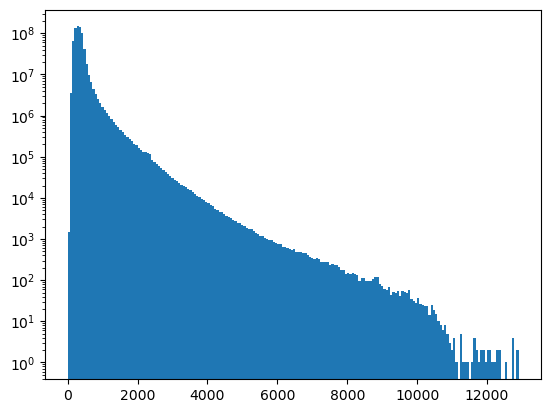

In [44]:
plt.hist(y.flatten(), bins=200)
plt.yscale('log')

In [55]:
from scipy import ndimage

blur_bg=ndimage.gaussian_filter(y[0].astype('float'), sigma=300, truncate=3)

In [83]:
mean_img=np.mean(y, axis=0)
blur_bg=ndimage.gaussian_filter(mean_img, sigma=80)


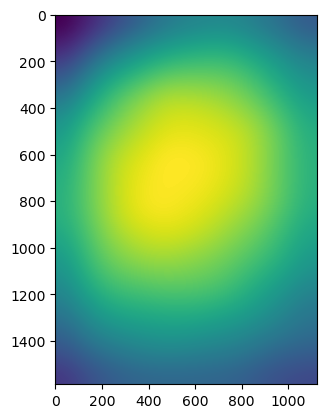

In [89]:
blur_bg=ndimage.gaussian_filter(mean_img, sigma=80)
plt.imshow(blur_bg)

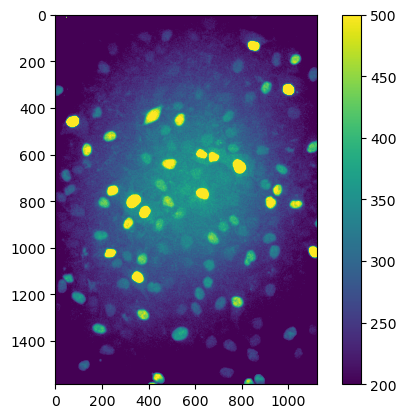

In [72]:
plt.imshow(y[0], vmin=200, vmax=500)
plt.colorbar()

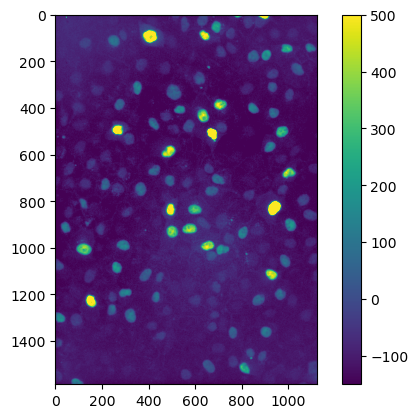

In [97]:
plt.imshow(y[40]-blur_bg, vmin=-150, vmax=500)
plt.colorbar()

-33.1548708259875


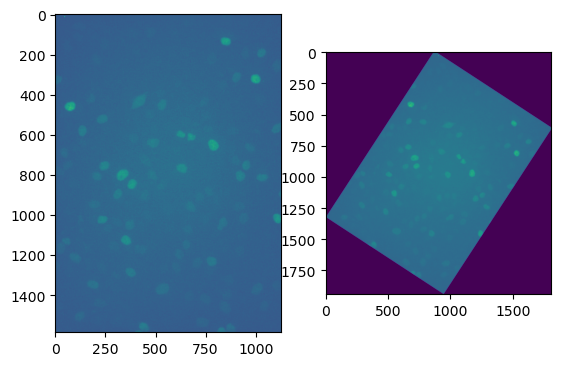

In [5]:
# TODO: random rotation
import skimage

rotation_angle=np.random.uniform(-45, 45)
print(rotation_angle)
rotated=skimage.transform.rotate(X[0],rotation_angle, resize=True, preserve_range=True)

fig, axes=plt.subplots(1,2)
axes[0].imshow(X[0], vmax=300)
axes[1].imshow(rotated, vmax=300)

In [29]:
def slice_data(img, window_x, window_y):
    n_blocks=np.array(img.shape)//[window_y, window_x]
    big_window_y, big_window_x=(img.shape/n_blocks).astype('int')
    window=min(big_window_y, big_window_x) # this is stupid but I don't want to think about where it's window x and where it's window y below

    img = img[:n_blocks[0]*window, :n_blocks[1]*window]

    output = img.reshape((-1, window, img.shape[1]//window, window))  
    return np.array(output.transpose((0,2,1,3)).reshape(-1, window, window)[:, :window_x, :window_y])

In [31]:
def random_slice(shape, target_size=(256,256)):
    height, width=shape
    crop_x=np.random.randint(0, width-target_size[0]+1)
    crop_y=np.random.randint(0, height-target_size[1]+1)
    return slice(crop_y, crop_y+target_size[1]), slice(crop_x, crop_x+target_size[0])

In [32]:
X=X/X.std()
y=y/y.std()

In [48]:
input_shape=(256,256)
dataset_X=[]
dataset_y=[]
for X_img, y_img in zip(tqdm(X), y):
    #X_img=X_img/X_img.std()
    #y_img=y_img/y_img.std()
    # X_blocks=slice_data(X_img, *input_shape)[...,np.newaxis]
    # y_blocks=slice_data(y_img, *input_shape)[...,np.newaxis]
    crop_y, crop_x = random_slice(X_img.shape, input_shape)
    dataset_X.append(X_img[crop_y, crop_x, np.newaxis])
    dataset_y.append(y_img[crop_y, crop_x, np.newaxis])
#dataset_X=np.concatenate(dataset_X)
#dataset_y=np.concatenate(dataset_y)
    
dataset_X=np.array(dataset_X)/np.quantile(dataset_X, 0.9)
dataset_y=np.array(dataset_y)/np.quantile(dataset_y, 0.9)

100%|██████████| 388/388 [00:00<00:00, 188770.44it/s]

In [47]:
np.quantile(dataset_X, 0.9),np.quantile(dataset_y, 0.9)

(1.95778297771856, 2.50244496082372)

(0.0, 5.0)

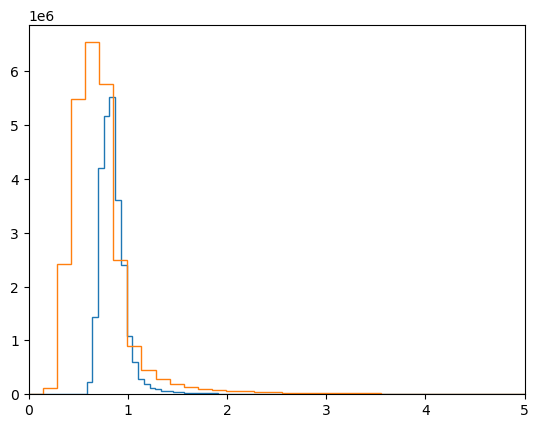

In [50]:
plt.hist(dataset_X.flatten(), bins=100, histtype='step')
plt.hist(dataset_y.flatten(), bins=100, histtype='step')

plt.xlim(0,5)

## MLP autoencoder

In [54]:
cutoff_percentage=0.8
cutoff=int(len(dataset_X)*cutoff_percentage)
train_X=dataset_X[:cutoff]
train_y=dataset_y[:cutoff]
test_X=dataset_X[cutoff:]
test_y=dataset_y[cutoff:]

In [9]:
input_shape=train_X.shape[1:-1]
stacked_encoder = tf.keras.Sequential([
    tf.keras.layers.Flatten(input_shape=input_shape),
    tf.keras.layers.Dense(100, activation="relu", kernel_initializer=tf.keras.initializers.orthogonal(seed=42), bias_initializer='zeros'),
    tf.keras.layers.Dense(100, activation="relu", kernel_initializer=tf.keras.initializers.orthogonal(seed=43), bias_initializer='zeros'), # one encoded value (ideally corresponding to angle of the bar)
    #tf.keras.layers.ActivityRegularization(l1=1e-4) # penalize by the number of active nodes. Reduce dimensionality as much as possible.
])
stacked_decoder = tf.keras.Sequential([
    tf.keras.layers.Dense(100, activation="relu", kernel_initializer=tf.keras.initializers.orthogonal(seed=44), bias_initializer='zeros'),
    tf.keras.layers.Dense(np.product(input_shape), kernel_initializer=tf.keras.initializers.orthogonal(seed=45), bias_initializer='zeros'),
tf.keras.layers.Reshape(input_shape)
])
stacked_ae = tf.keras.Sequential([stacked_encoder, stacked_decoder])

In [2]:
train_X, train_y, test_X, test_y = load_data(input_shape=(100,100), random_crop=False)

In [3]:
train_X.shape

(51216, 100, 100, 1)

In [3]:
input_shape=train_X.shape[1:-1]
simple_ae = keras.Sequential([
    layers.Flatten(input_shape=input_shape),
    layers.Dense(1000, kernel_initializer=tf.keras.initializers.GlorotUniform(seed=42), bias_initializer='zeros'),
    layers.Dense(1000, kernel_initializer=tf.keras.initializers.GlorotUniform(seed=42), bias_initializer='zeros'),
    layers.Dense(np.product(input_shape), kernel_initializer=tf.keras.initializers.GlorotUniform(seed=45), bias_initializer='zeros'),
    layers.Reshape(input_shape)
])
simple_ae.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten (Flatten)           (None, 10000)             0         
                                                                 
 dense (Dense)               (None, 1000)              10001000  
                                                                 
 dense_1 (Dense)             (None, 1000)              1001000   
                                                                 
 dense_2 (Dense)             (None, 10000)             10010000  
                                                                 
 reshape (Reshape)           (None, 100, 100)          0         
                                                                 
Total params: 21,012,000
Trainable params: 21,012,000
Non-trainable params: 0
_________________________________________________________________


In [4]:
model_file='checkpoints/simple_checkpoint-{epoch}.hdf5'
checkpoint = tf.keras.callbacks.ModelCheckpoint(model_file, 
                                                monitor="val_loss", mode="min", 
                                                save_best_only=True, verbose=1)

early_stop = tf.keras.callbacks.EarlyStopping(monitor='val_loss', 
                                              patience = 50, restore_best_weights = True)

In [6]:
simple_ae.compile(loss="mse", optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001))
history = simple_ae.fit(train_X, train_y, epochs=1000, shuffle=True, batch_size=32, validation_split=0.2, callbacks=[checkpoint])

Epoch 1/1000
1272/1281 [============================>.] - ETA: 0s - loss: 0.0549
Epoch 1: val_loss did not improve from 0.05629
1281/1281 [==============================] - 7s 6ms/step - loss: 0.0548 - val_loss: 0.0579
Epoch 2/1000
1277/1281 [============================>.] - ETA: 0s - loss: 0.0464
Epoch 2: val_loss improved from 0.05629 to 0.05195, saving model to checkpoints\simple_checkpoint-2.hdf5
1281/1281 [==============================] - 7s 6ms/step - loss: 0.0465 - val_loss: 0.0519
Epoch 3/1000
1281/1281 [==============================] - ETA: 0s - loss: 0.0424
Epoch 3: val_loss improved from 0.05195 to 0.03899, saving model to checkpoints\simple_checkpoint-3.hdf5
1281/1281 [==============================] - 7s 6ms/step - loss: 0.0424 - val_loss: 0.0390
Epoch 4/1000
1273/1281 [============================>.] - ETA: 0s - loss: 0.0356
Epoch 4: val_loss improved from 0.03899 to 0.03825, saving model to checkpoints\simple_checkpoint-4.hdf5
1281/1281 [==============================

In [7]:
simple_ae.load_weights(model_file.format(epoch=441))

In [15]:
simple_ae.evaluate(test_X, test_y)

401/401 [==============================] - 1s 3ms/step - loss: 0.0069


0.006878348998725414

In [14]:
prediction=simple_ae.predict(test_X)

401/401 [==============================] - 1s 1ms/step


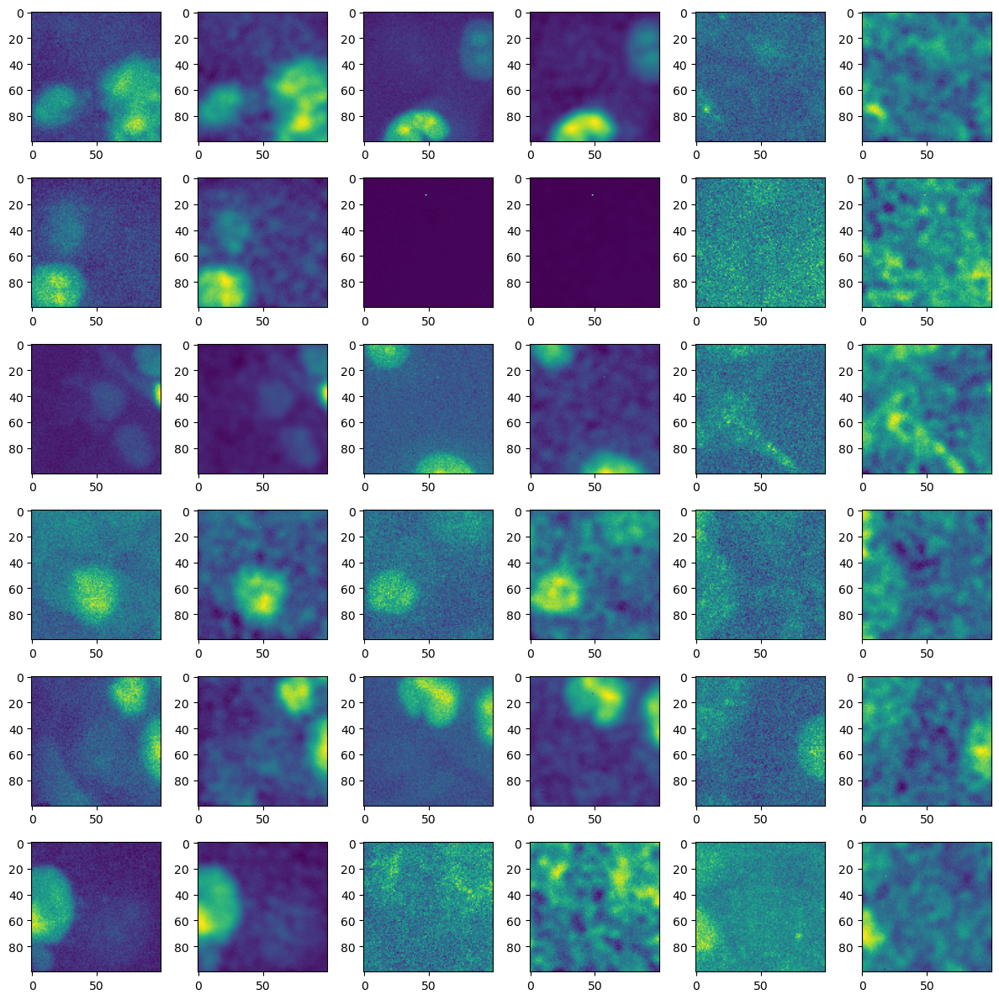

In [18]:
plot_random(test_y, prediction, 6, 3)

## CNN autoencoder

In [3]:
train_X, train_y, test_X, test_y = get_data(directory='F:/my_data/Data/20240228 FUCCI training', window_size=(512,512), subtract_background=True, random_crop=False)
print(train_X.shape)

(1862, 512, 512, 1)


In [25]:
X, y = preprocess_data(directory='F:/my_data/Data/20240228 FUCCI training')
X=X[...,:1584,:1120,np.newaxis]
y=y[...,:1584,:1120,np.newaxis]

train_X, train_y, test_X, test_y = train_test_split(X, y)

In [2]:
X, y = load_data()
from scipy import ndimage
mean_img=np.mean(y, axis=0)
blur_bg=ndimage.gaussian_filter(mean_img, sigma=80)
y=y-blur_bg
y-=y.min()
y=np.clip(y, a_min=0, a_max=65535).astype('uint16')
        
dataset_X=X/np.quantile(X, 0.9)
dataset_y=y/np.quantile(y, 0.9)
dataset_X=dataset_X[:,:1584,:1120,np.newaxis]
dataset_y=dataset_y[:,:1584,:1120,np.newaxis]

test_split=0.8
cutoff=int(len(dataset_X)*test_split)
train_X=dataset_X[:cutoff]
train_y=dataset_y[:cutoff]
test_X=dataset_X[cutoff:]
test_y=dataset_y[cutoff:]

In [ ]:
input_shape=train_X.shape[1:-1]
# complete (?) cnn autoencoder
conv_ae = tf.keras.Sequential([
    layers.Input(shape=(*input_shape, 1)),
    layers.Conv2D(32, (5,5), activation='relu',padding='same'),
    layers.Conv2D(32, (3,3), activation='relu',padding='same'),
    layers.Conv2D(32, (5,5), activation='relu',padding='same'),
    layers.Conv2D(32, (3,3), activation='relu',padding='same'),
    layers.Conv2D(32, (5,5), activation='relu',padding='same'),
    layers.Conv2D(32, (3,3), activation='relu',padding='same'),
    layers.Conv2D(32, (5,5), activation='relu',padding='same'),
    layers.Conv2D(32, (3,3), activation='relu',padding='same'),
    layers.Conv2D(32, (5,5), activation='relu',padding='same'),
    layers.Conv2D(32, (3,3), activation='relu',padding='same'),
    layers.Conv2D(1, (5,5), activation='relu',padding='same'),
    ])

conv_ae.summary()

In [27]:
input_shape=train_X.shape[1:-1]
n_filters=64
# undercomplete (?) cnn autoencoder
conv_ae = tf.keras.Sequential([
    layers.Input(shape=(*input_shape, 1)),
    layers.Conv2D(n_filters, (3,3), activation='relu',padding='same'),
    layers.Conv2D(n_filters, (3,3), activation='relu',padding='same'),
    layers.MaxPool2D(pool_size=2),
    layers.Conv2D(2*n_filters, (5,5), activation='relu',padding='same'),
    layers.MaxPool2D(pool_size=2),
    layers.Conv2D(4*n_filters, (3,3), activation='relu',padding='same'),
    layers.Conv2D(4*n_filters, (5,5), activation='relu',padding='same'),
    layers.MaxPool2D(pool_size=2),
    layers.Conv2D(8*n_filters, (3,3), activation='relu',padding='same'),
    layers.Conv2DTranspose(4*n_filters, (3,3), strides=2, activation='relu', padding='same'),
    layers.Conv2D(4*n_filters, (5,5), activation='relu', padding='same'),
    layers.Conv2DTranspose(2*n_filters, (3,3), strides=2, activation='relu', padding='same'),
    layers.Conv2D(2*n_filters, (5,5), activation='relu', padding='same'),
    layers.Conv2DTranspose(n_filters, (3,3), strides=2, activation='relu', padding='same'),
    layers.Conv2D(1,(3,3), activation='relu', padding='same')])

conv_ae.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_36 (Conv2D)          (None, 1584, 1120, 64)    640       
                                                                 
 conv2d_37 (Conv2D)          (None, 1584, 1120, 64)    36928     
                                                                 
 max_pooling2d_12 (MaxPoolin  (None, 792, 560, 64)     0         
 g2D)                                                            
                                                                 
 conv2d_38 (Conv2D)          (None, 792, 560, 128)     204928    
                                                                 
 max_pooling2d_13 (MaxPoolin  (None, 396, 280, 128)    0         
 g2D)                                                            
                                                                 
 conv2d_39 (Conv2D)          (None, 396, 280, 256)    

In [28]:
model_name='0303-fliprotate0228-conv_under_512_512-checkpoint-25-0.0126'
conv_ae.load_weights(f'checkpoints/{model_name}.hdf5')

In [21]:
model_file='checkpoints/0303-fliprotate0228-conv_under_512_512-checkpoint-{epoch}-{val_loss:.4f}.hdf5'
checkpoint = tf.keras.callbacks.ModelCheckpoint(model_file, 
                                                monitor="val_loss", mode="min", 
                                                save_best_only=True, verbose=1)

#early_stop = tf.keras.callbacks.EarlyStopping(monitor='val_loss', 
#                                              patience = 50, restore_best_weights = True)

In [22]:
conv_ae.compile(loss="mse", optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001))
history = conv_ae.fit(train_X, train_y, epochs=1000, initial_epoch=34, shuffle=True, batch_size=2, validation_split=0.2, callbacks=[checkpoint])

Epoch 1/1000
745/745 [==============================] - ETA: 0s - loss: 0.0115
Epoch 1: val_loss improved from inf to 0.01717, saving model to checkpoints\0303-fliprotate0228-conv_under_512_512-checkpoint-1-0.0172.hdf5
745/745 [==============================] - 264s 330ms/step - loss: 0.0115 - val_loss: 0.0172
Epoch 2/1000
745/745 [==============================] - ETA: 0s - loss: 0.0113
Epoch 2: val_loss did not improve from 0.01717
745/745 [==============================] - 238s 320ms/step - loss: 0.0113 - val_loss: 0.0184
Epoch 3/1000
745/745 [==============================] - ETA: 0s - loss: 0.0111
Epoch 3: val_loss did not improve from 0.01717
745/745 [==============================] - 238s 319ms/step - loss: 0.0111 - val_loss: 0.0173
Epoch 4/1000
745/745 [==============================] - ETA: 0s - loss: 0.0110
Epoch 4: val_loss did not improve from 0.01717
745/745 [==============================] - 238s 319ms/step - loss: 0.0110 - val_loss: 0.0176
Epoch 5/1000
745/745 [=========

KeyboardInterrupt: 

In [29]:
conv_ae.compile(loss="mse", optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001))

conv_ae.evaluate(test_X, test_y, batch_size=1)

78/78 [==============================] - 42s 374ms/step - loss: 0.0100


0.00998971238732338

In [30]:
#conv_ae.compile(loss="mse", optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001))
prediction=conv_ae.predict(test_X, batch_size=1)

78/78 [==============================] - 30s 378ms/step


In [37]:
np.quantile(test_X[-1], (0,0.9))

array([0.33333333, 1.01388889])

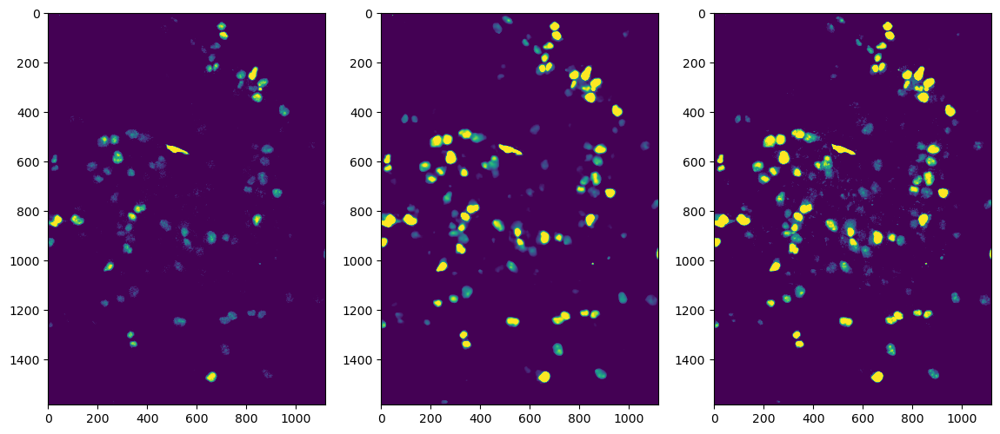

In [56]:
fig, axes=plt.subplots(1,3, figsize=(14,10))
axes[0].imshow(test_X[-2], vmin=1, vmax=1.5)
axes[1].imshow(prediction[-2], vmin=0.95, vmax=1.5)
#axes[2].imshow(normalized, vmax=0.4)
axes[2].imshow(test_y[-2], vmin=1, vmax=1.5)

In [23]:
img_data=prediction[-1].flatten()

lower_bound=np.exp(np.log(img_data.astype('float64')+1).mean())
std=img_data.std()

normalized=np.clip((prediction[-1]-lower_bound)/std, a_min=0, a_max=None)

In [ ]:
fig, axes=plt.subplots(4,2, figsize=(8,16))
for X_img, y_img, axpair in zip(test_X[-4:], prediction[-4:], axes):
    cbar=axpair[0].imshow(X_img[500:600,500:600])
    plt.colorbar(cbar, ax=axpair[0])
    cbar=axpair[1].imshow(y_img[500:600,500:600])
    plt.colorbar(cbar, ax=axpair[1])

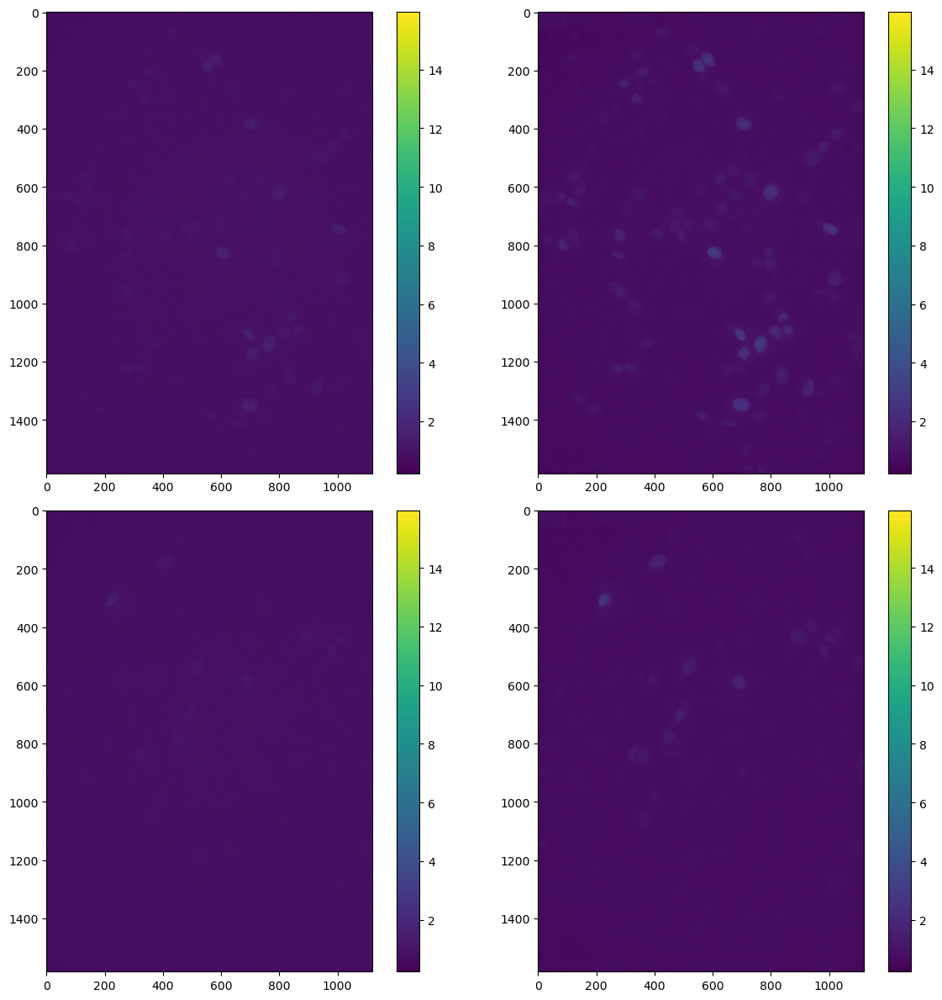

In [32]:
plot_random(test_X, prediction, 2, 1, figsize=6)

## CNN skip autoencoder (U-Net)

### load data from TIFs

In [193]:
tile_size=256
train_X, train_y, test_X, test_y = [], [], [], []
for directory in tqdm(['F:/my_data/Data/20240316 FUCCI halo training/blurred/',
                       'F:/my_data/Data/20240318 FUCCI training/t1/blurred']):
    data = get_data(directory=directory,
                    window_size=(tile_size,tile_size),
                    subtract_background=False,
                    crop_mode='slice',
                    rotate=True,
                    test_split=0.8)
    
    train_X.append(data[0])
    train_y.append(data[1])
    test_X.append(data[2])
    test_y.append(data[3])

train_X=np.concatenate(train_X)
train_y=np.concatenate(train_y)
test_X=np.concatenate(test_X)
test_y=np.concatenate(test_y)

  0%|          | 0/2 [00:00<?, ?it/s]

In [194]:
# set numpy random seed
np.random.seed(42)

# randomly sample validation set
n_samples=len(train_X)
n_val_samples=int(n_samples*0.2)
val_indices=np.random.choice(n_samples, n_val_samples, replace=False)
train_indices=np.setdiff1d(np.arange(n_samples), val_indices)

val_X=train_X[val_indices]
val_y=train_y[val_indices]
train_X=train_X[train_indices]
train_y=train_y[train_indices]

train_X.shape, val_X.shape, train_y.shape, val_y.shape

((12964, 256, 256, 1),
 (3240, 256, 256, 1),
 (12964, 256, 256, 1),
 (3240, 256, 256, 1))

### export to TFRecord

In [198]:
def write_tfrecord(X, y, filename):
    with tf.io.TFRecordWriter(filename) as writer:
        for X_img, y_img in zip(tqdm(X, leave=False, desc=filename), y):
            writer.write(tf.io.serialize_tensor([X_img, y_img]).numpy())

In [200]:
write_tfrecord(val_X, val_y, 'training_data/validation.tfrecord')
write_tfrecord(test_X, test_y, 'training_data/test.tfrecord')

# split training data into n chunks with remainder
n_chunks=14
chunk_size=len(train_X)//n_chunks
train_X_chunks=np.array_split(train_X, n_chunks)
train_y_chunks=np.array_split(train_y, n_chunks)

filepaths=[f"training_data/train_{i}.tfrecord" for i in range(n_chunks)]
for filepath, X_chunk, y_chunk in zip(tqdm(filepaths), train_X_chunks, train_y_chunks):
    write_tfrecord(X_chunk, y_chunk, filepath)

training_data/validation.tfrecord:   0%|          | 0/3240 [00:00<?, ?it/s]

training_data/test.tfrecord:   0%|          | 0/4052 [00:00<?, ?it/s]

  0%|          | 0/14 [00:00<?, ?it/s]

training_data/train_0.tfrecord:   0%|          | 0/926 [00:00<?, ?it/s]

training_data/train_1.tfrecord:   0%|          | 0/926 [00:00<?, ?it/s]

training_data/train_2.tfrecord:   0%|          | 0/926 [00:00<?, ?it/s]

training_data/train_3.tfrecord:   0%|          | 0/926 [00:00<?, ?it/s]

training_data/train_4.tfrecord:   0%|          | 0/926 [00:00<?, ?it/s]

training_data/train_5.tfrecord:   0%|          | 0/926 [00:00<?, ?it/s]

training_data/train_6.tfrecord:   0%|          | 0/926 [00:00<?, ?it/s]

training_data/train_7.tfrecord:   0%|          | 0/926 [00:00<?, ?it/s]

training_data/train_8.tfrecord:   0%|          | 0/926 [00:00<?, ?it/s]

training_data/train_9.tfrecord:   0%|          | 0/926 [00:00<?, ?it/s]

training_data/train_10.tfrecord:   0%|          | 0/926 [00:00<?, ?it/s]

training_data/train_11.tfrecord:   0%|          | 0/926 [00:00<?, ?it/s]

training_data/train_12.tfrecord:   0%|          | 0/926 [00:00<?, ?it/s]

training_data/train_13.tfrecord:   0%|          | 0/926 [00:00<?, ?it/s]

### read from TFRecord

In [2]:
def parse(serialized):
    return tf.io.parse_tensor(serialized, out_type=tf.float64)

def train_X_y(dataset_line):
    parsed_line=parse(dataset_line)
    return parsed_line[0], parsed_line[1]

In [5]:
from glob import glob
from natsort import natsorted

filepaths = natsorted(glob('training_data/train_*.tfrecord'))

train_dataset = tf.data.TFRecordDataset(filepaths, num_parallel_reads=5).shuffle(4000).map(train_X_y, num_parallel_calls=tf.data.AUTOTUNE).batch(24).prefetch(1)

In [9]:
BATCH_SIZE=24
val_dataset = tf.data.TFRecordDataset('training_data/validation.tfrecord').map(train_X_y).batch(BATCH_SIZE).prefetch(1)
test_dataset = tf.data.TFRecordDataset('training_data/test.tfrecord').map(train_X_y).batch(BATCH_SIZE).prefetch(1)

### train model

In [7]:
import keras.layers as layers
import keras.models as models
from keras.initializers import orthogonal

DROPOUT=0.4

def Conv2DLayer(x, filters, kernel, strides, padding, block_id, kernel_init=orthogonal(seed=42)):
    prefix = f'block_{block_id}_'
    x = layers.Conv2D(filters, kernel_size=kernel, strides=strides, padding=padding,
                      kernel_initializer=kernel_init, name=prefix+'conv')(x)
    x = layers.LeakyReLU(name=prefix+'lrelu')(x)
    x = layers.Dropout(DROPOUT, name=prefix+'drop')((x))
    x = layers.BatchNormalization(name=prefix+'conv_bn')(x)
    return x

def Transpose_Conv2D(x, filters, kernel, strides, padding, block_id, kernel_init=orthogonal(seed=43)):
    prefix = f'block_{block_id}_'
    x = layers.Conv2DTranspose(filters, kernel_size=kernel, strides=strides, padding=padding,
                               kernel_initializer=kernel_init, name=prefix+'de-conv')(x)
    x = layers.LeakyReLU(name=prefix+'lrelu')(x)
    x = layers.Dropout(DROPOUT, name=prefix+'drop')((x))
    x = layers.BatchNormalization(name=prefix+'conv_bn')(x)
    return x



def AutoEncoder(input_shape):
    inputs = layers.Input(shape=input_shape)
    
    # 256 x 256
    conv1 = Conv2DLayer(inputs, 64, 3, strides=1, padding='same', block_id=1)
    conv2 = Conv2DLayer(conv1, 64, 3, strides=2, padding='same', block_id=2)
    
    # 128 x 128
    conv3 = Conv2DLayer(conv2, 128, 5, strides=2, padding='same', block_id=3)
    
    # 64 x 64
    conv4 = Conv2DLayer(conv3, 128, 3, strides=1, padding='same', block_id=4)
    conv5 = Conv2DLayer(conv4, 256, 5, strides=2, padding='same', block_id=5)
    
    # 32 x 32
    conv6 = Conv2DLayer(conv5, 512, 3, strides=2, padding='same', block_id=6)
    
    # 16 x 16
    deconv1 = Transpose_Conv2D(conv6, 512, 3, strides=2, padding='same', block_id=7)
    
    # 32 x 32
    skip1 = layers.concatenate([deconv1, conv5], name='skip1')
    conv7 = Conv2DLayer(skip1, 256, 3, strides=1, padding='same', block_id=8)
    deconv2 = Transpose_Conv2D(conv7, 128, 3, strides=2, padding='same', block_id=9)
    
    # 64 x 64
    skip2 = layers.concatenate([deconv2, conv3], name='skip2')
    conv8 = Conv2DLayer(skip2, 128, 5, strides=1, padding='same', block_id=10)
    deconv3 = Transpose_Conv2D(conv8, 64, 3, strides=2, padding='same', block_id=11)
    
    # 128 x 128
    skip3 = layers.concatenate([deconv3, conv2], name='skip3')
    conv9 = Conv2DLayer(skip3, 64, 5, strides=1, padding='same', block_id=12)
    deconv4 = Transpose_Conv2D(conv9, 64, 3, strides=2, padding='same', block_id=13)
    
    # 256 x 256
    skip4 = layers.concatenate([deconv4, conv1], name='skip4')
    conv10 = layers.Conv2D(1, 3, strides=1, padding='same', activation='relu',
                       kernel_initializer=orthogonal(seed=44), name='final_conv')(skip4)

    
    return models.Model(inputs=inputs, outputs=conv10)

In [8]:
def UNet(input_shape, filters=16):
    inputs = layers.Input(shape=input_shape)
    # 256->128
    conv0=Conv2DLayer(inputs, filters, 3, strides=1, padding='same', block_id=0)
    conv1 = Conv2DLayer(conv0, 2*filters, 5, strides=2, padding='same', block_id=1)
    # 128->64
    conv2 = Conv2DLayer(conv1, 4*filters, 5, strides=2, padding='same', block_id=2)
    # 64->32
    conv3 = Conv2DLayer(conv2, 4*filters, 3, strides=1, padding='same', block_id=3)
    conv4 = Conv2DLayer(conv3, 8*filters, 3, strides=2, padding='same', block_id=4)

    # 32->64
    deconv1 = Transpose_Conv2D(conv4, 8*filters, 3, strides=2, padding='same', block_id=5)

    # 64->128
    skip = layers.concatenate([deconv1, conv2])
    conv4 = Conv2DLayer(skip, 8*filters, 3, strides=1, padding='same', block_id=6)
    deconv2=Transpose_Conv2D(conv4, 4*filters, 5, strides=2, padding='same', block_id=7)

    # 128-256
    skip = layers.concatenate([deconv2, conv1])
    deconv3=Transpose_Conv2D(skip, 2*filters, 5, strides=2, padding='same', block_id=8)

    skip = layers.concatenate([deconv3, conv0])
    convFinal = layers.Conv2D(1, 3, strides=1, padding='same', activation='relu',
                       kernel_initializer=orthogonal(seed=44), name='final_conv')(skip)
    
    return models.Model(inputs=inputs, outputs=convFinal)

In [10]:
model=UNet((256,256,1), filters=32)
model.compile(optimizer='adam', loss='mse')

In [9]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 256, 256, 1  0           []                               
                                )]                                                                
                                                                                                  
 block_0_conv (Conv2D)          (None, 256, 256, 32  320         ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 block_0_lrelu (LeakyReLU)      (None, 256, 256, 32  0           ['block_0_conv[0][0]']           
                                )                                                             

In [11]:
checkpoint_path='tf_checkpoints/FUCCI_denoiser/20240327/tile256-{epoch:03d}-{val_loss:.4f}.hdf5'
modelchk = keras.callbacks.ModelCheckpoint(checkpoint_path, 
                                      monitor='val_loss',
                                      verbose=1,
                                      save_best_only=True,
                                      save_weights_only=True,
                                      mode='auto',
                                      save_freq='epoch')

In [14]:
optimizer=tf.keras.optimizers.Adam(learning_rate=0.00001)
model.compile(optimizer=optimizer, loss='mse')

In [12]:
model.load_weights(r'tf_checkpoints/FUCCI_denoiser/20240327/tile256-004-0.0062.hdf5')

In [16]:
history=model.fit(train_dataset, initial_epoch=100, epochs=500, validation_data=val_dataset, callbacks=[modelchk])

Epoch 101/500


    541/Unknown - 361s 665ms/step - loss: 0.0057
Epoch 101: val_loss did not improve from 0.00418
541/541 [==============================] - 388s 716ms/step - loss: 0.0057 - val_loss: 0.0043
Epoch 102/500
541/541 [==============================] - ETA: 0s - loss: 0.0056
Epoch 102: val_loss did not improve from 0.00418
541/541 [==============================] - 376s 693ms/step - loss: 0.0056 - val_loss: 0.0042
Epoch 103/500
541/541 [==============================] - ETA: 0s - loss: 0.0056
Epoch 103: val_loss did not improve from 0.00418
541/541 [==============================] - 376s 693ms/step - loss: 0.0056 - val_loss: 0.0043
Epoch 104/500
541/541 [==============================] - ETA: 0s - loss: 0.0058
Epoch 104: val_loss did not improve from 0.00418
541/541 [==============================] - 376s 693ms/step - loss: 0.0058 - val_loss: 0.0043
Epoch 105/500
541/541 [==============================] - ETA: 0s - loss: 0.0056
Epoch 105: val_loss did not improve from 0.00418
541/541 [=====

KeyboardInterrupt: 

In [ ]:
optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001)
model.compile(optimizer=optimizer, loss='mse')

In [208]:
from keras.optimizers import SGD, Adam
LEARNING_RATE=0.0001
model = AutoEncoder((256,256,1))
model_opt = Adam(learning_rate=LEARNING_RATE)

model.compile(optimizer=model_opt, loss='mse', metrics=['accuracy'])

checkpoint_path='tf_checkpoints/FUCCI_denoiser/20240326/tile256-{epoch:03d}-{val_loss:.4f}.hdf5'
modelchk = keras.callbacks.ModelCheckpoint(checkpoint_path, 
                                      monitor='val_loss',
                                      verbose=1,
                                      save_best_only=True,
                                      save_weights_only=True,
                                      mode='auto',
                                      save_freq='epoch')

In [22]:
model.load_weights(r'tf_checkpoints\FUCCI_denoiser\20240326\width32_depth10\tile256-047-0.0039.hdf5')

In [209]:
model.fit(train_dataset, epochs=100, validation_data=val_dataset, callbacks=[modelchk])

Epoch 1/100


ValueError: in user code:

    File "c:\Users\Andy\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\training.py", line 1160, in train_function  *
        return step_function(self, iterator)
    File "c:\Users\Andy\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\training.py", line 1146, in step_function  **
        outputs = model.distribute_strategy.run(run_step, args=(data,))
    File "c:\Users\Andy\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\training.py", line 1135, in run_step  **
        outputs = model.train_step(data)
    File "c:\Users\Andy\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\training.py", line 998, in train_step
        return self.compute_metrics(x, y, y_pred, sample_weight)
    File "c:\Users\Andy\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\training.py", line 1092, in compute_metrics
        self.compiled_metrics.update_state(y, y_pred, sample_weight)
    File "c:\Users\Andy\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\compile_utils.py", line 577, in update_state
        self.build(y_pred, y_true)
    File "c:\Users\Andy\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\compile_utils.py", line 483, in build
        self._metrics = tf.__internal__.nest.map_structure_up_to(
    File "c:\Users\Andy\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\compile_utils.py", line 631, in _get_metric_objects
        return [self._get_metric_object(m, y_t, y_p) for m in metrics]
    File "c:\Users\Andy\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\compile_utils.py", line 631, in <listcomp>
        return [self._get_metric_object(m, y_t, y_p) for m in metrics]
    File "c:\Users\Andy\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\compile_utils.py", line 652, in _get_metric_object
        y_t_rank = len(y_t.shape.as_list())

    ValueError: as_list() is not defined on an unknown TensorShape.


In [18]:
model.fit(train_dataset,
          validation_data=val_dataset,
          shuffle=True,
          initial_epoch=0,
          batch_size=2,
          epochs=1000,
          verbose=1,
          callbacks=[modelchk])

ValueError: in user code:

    File "c:\Users\Andy\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\training.py", line 1160, in train_function  *
        return step_function(self, iterator)
    File "c:\Users\Andy\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\training.py", line 1146, in step_function  **
        outputs = model.distribute_strategy.run(run_step, args=(data,))
    File "c:\Users\Andy\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\training.py", line 1135, in run_step  **
        outputs = model.train_step(data)
    File "c:\Users\Andy\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\training.py", line 998, in train_step
        return self.compute_metrics(x, y, y_pred, sample_weight)
    File "c:\Users\Andy\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\training.py", line 1092, in compute_metrics
        self.compiled_metrics.update_state(y, y_pred, sample_weight)
    File "c:\Users\Andy\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\compile_utils.py", line 577, in update_state
        self.build(y_pred, y_true)
    File "c:\Users\Andy\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\compile_utils.py", line 483, in build
        self._metrics = tf.__internal__.nest.map_structure_up_to(
    File "c:\Users\Andy\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\compile_utils.py", line 631, in _get_metric_objects
        return [self._get_metric_object(m, y_t, y_p) for m in metrics]
    File "c:\Users\Andy\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\compile_utils.py", line 631, in <listcomp>
        return [self._get_metric_object(m, y_t, y_p) for m in metrics]
    File "c:\Users\Andy\anaconda3\envs\tensorflow\lib\site-packages\keras\engine\compile_utils.py", line 652, in _get_metric_object
        y_t_rank = len(y_t.shape.as_list())

    ValueError: as_list() is not defined on an unknown TensorShape.


In [31]:
item=[item for item in val_dataset.shuffle(1000).take(1)][0]

1/1 [==============================] - 0s 17ms/step


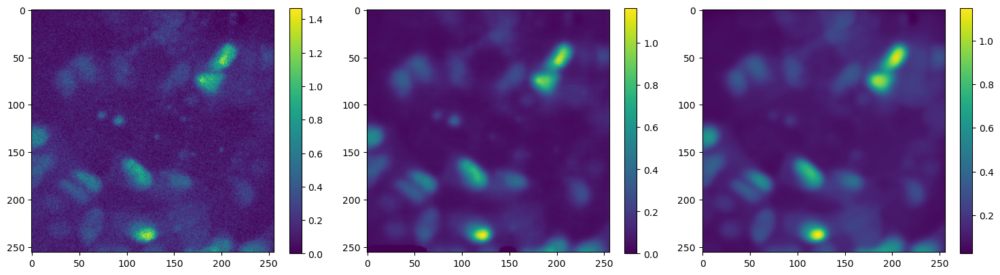

1/1 [==============================] - 0s 18ms/step


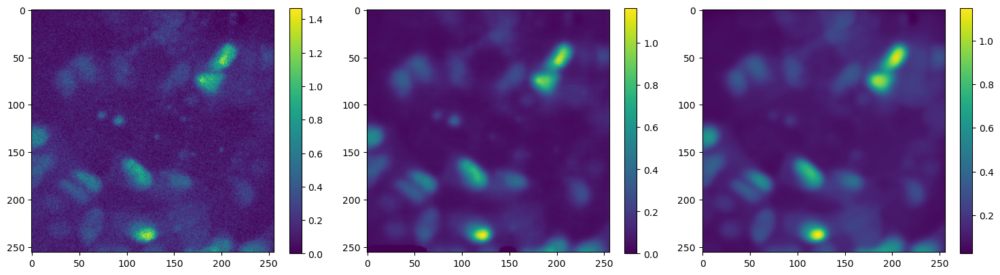

In [32]:
model.load_weights(r'tf_checkpoints\FUCCI_denoiser\20240326\width32_depth10\tile256-047-0.0039.hdf5')
prediction=model.predict(item[0][0].numpy()[np.newaxis,...])

fig, axes=plt.subplots(1,3, figsize=(15,4))
cbar=axes[0].imshow(item[0][0].numpy().squeeze())
plt.colorbar(cbar, ax=axes[0])
cbar=axes[1].imshow(prediction.squeeze())
plt.colorbar(cbar, ax=axes[1])
cbar=axes[2].imshow(item[1][0].numpy().squeeze())
plt.colorbar(cbar, ax=axes[2])

fig.tight_layout()
plt.show()

prediction=model.predict(item[0][0].numpy()[np.newaxis,...])
model.load_weights(r'tf_checkpoints\FUCCI_denoiser\20240327\tile256-107-0.0041.hdf5')
fig, axes=plt.subplots(1,3, figsize=(15,4))
cbar=axes[0].imshow(item[0][0].numpy().squeeze())
plt.colorbar(cbar, ax=axes[0])
cbar=axes[1].imshow(prediction.squeeze())
plt.colorbar(cbar, ax=axes[1])
cbar=axes[2].imshow(item[1][0].numpy().squeeze())
plt.colorbar(cbar, ax=axes[2])

fig.tight_layout()
plt.show()

1/1 [==============================] - 0s 18ms/step


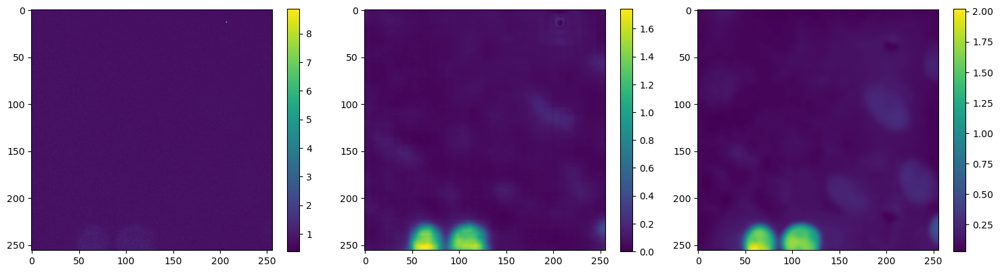

In [9]:
from glob import glob
from pathlib import Path

checkpoints=str(Path(checkpoint_path).parent)+'/*.hdf5'
last_checkpoint=glob(checkpoints)[-1]

print('loading weights from', last_checkpoint)
model.load_weights(last_checkpoint)

loading weights from tf_checkpoints\FUCCI_denoiser\20240317-0228_and_0316\skip_CNN256-132-0.0034.hdf5


In [8]:
model.evaluate(test_X, test_y, batch_size=1)

971/971 [==============================] - 51s 49ms/step - loss: 0.0238 - accuracy: 0.8683


[0.023848095908761024, 0.8682635426521301]

In [14]:
prediction=model.predict(test_X[:500], batch_size=4)

125/125 [==============================] - 6s 50ms/step


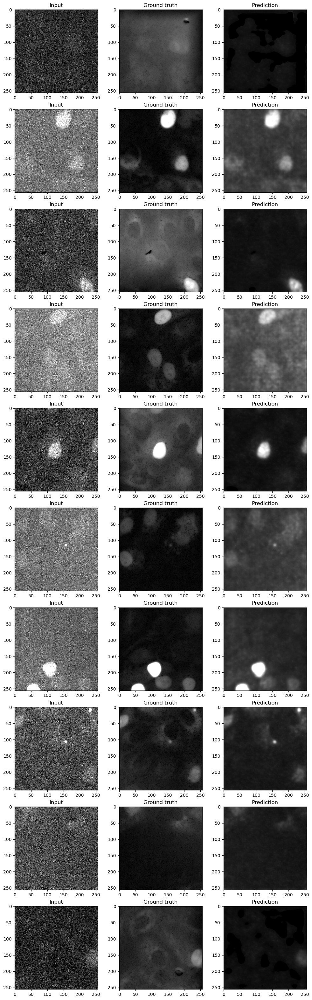

In [16]:
# plot sample inputs, predictions
n_rows=10
fig, axes = plt.subplots(n_rows, 3, figsize=(12, n_rows*4))

# random sample indices
sample_indices = np.random.choice(np.arange(len(prediction)), size=n_rows, replace=False)

for ax, index in zip(axes, sample_indices):
    ax[0].imshow(test_X[index], cmap='gray', vmin=0.6, vmax=1)
    ax[1].imshow(test_y[index], cmap='gray', vmin=0,vmax=1)
    ax[2].imshow(prediction[index], cmap='gray', vmin=0,vmax=1)

    ax[0].set_title('Input')
    ax[1].set_title('Ground truth')
    ax[2].set_title('Prediction')

## tiling and stitching

In [31]:
X, y = preprocess_data('F:/my_data/Data/20240316 FUCCI halo training/blurred/', subtract_background=False, norm_quantile=0.99)

In [63]:
X.shape

(422, 1586, 1125)

In [65]:
full_UNet=UNet((1584,1120,1), filters=32)

In [66]:
full_UNet.load_weights(r'tf_checkpoints\FUCCI_denoiser\20240326\tile256-047-0.0039.hdf5')

In [67]:
full_UNet.compile(optimizer='adam', loss='mse')

In [74]:
prediction=full_UNet.predict(X[:20, :1584, :1120, np.newaxis], batch_size=1)

20/20 [==============================] - 5s 269ms/step


In [76]:
full_UNet.evaluate(X[:20, :1584, :1120, np.newaxis], y[:20, :1584, :1120, np.newaxis], batch_size=1)

20/20 [==============================] - 6s 252ms/step - loss: 0.0086


0.008590125478804111

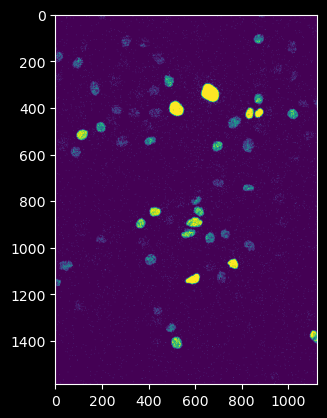

In [87]:
plt.imshow(X[3]>0.9)

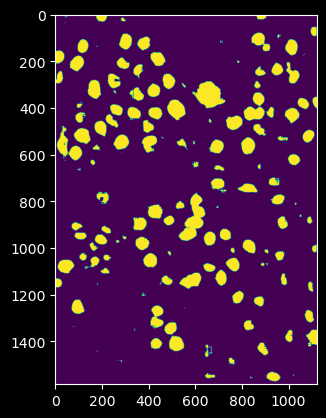

In [82]:
plt.imshow(prediction[3]>0.2)

In [90]:
labels=ndimage.label(prediction[3][...,0]>0.2)

In [93]:
np.unique(labels[0], return_counts=True)

(array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
         13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
         26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
         39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
         52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
         65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
         78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
         91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
        104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
        117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
        130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 142,
        143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155,
        156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168,
        169, 170, 171, 172, 173, 174, 175, 176, 177

In [160]:
from scipy.optimize import minimize_scalar

def nuclear_threshold_loss(threshold, img, size_threshold):
    labels, n_features=ndimage.label(img>threshold)
    n_nuclei=np.sum(np.unique(labels, return_counts=True)[1][1:]>size_threshold)
    return -(n_nuclei-0.1*n_features)

def get_fluor_threshold(img, size_threshold):
    ret=minimize_scalar(nuclear_threshold_loss, bounds=np.quantile(img, (0.5,0.95)), args=(img, size_threshold), options={'xatol':0.001})
    return ret['x'], nuclear_threshold_loss(ret['x'], img, size_threshold)

In [161]:
get_fluor_threshold(prediction[3], 500)

(0.2418303445730121, -77.0)

In [162]:
get_fluor_threshold(X[3], 500)

(0.836555548672922, 3690.6000000000004)

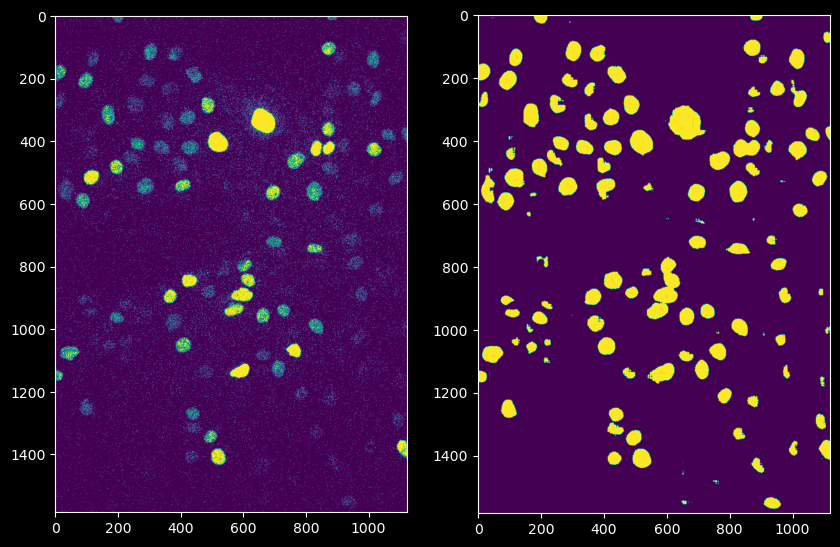

In [163]:
fig, axes=plt.subplots(1,2,figsize=(10,7))
axes[0].imshow(X[3]>0.8366)
axes[1].imshow(prediction[3]>0.2418)

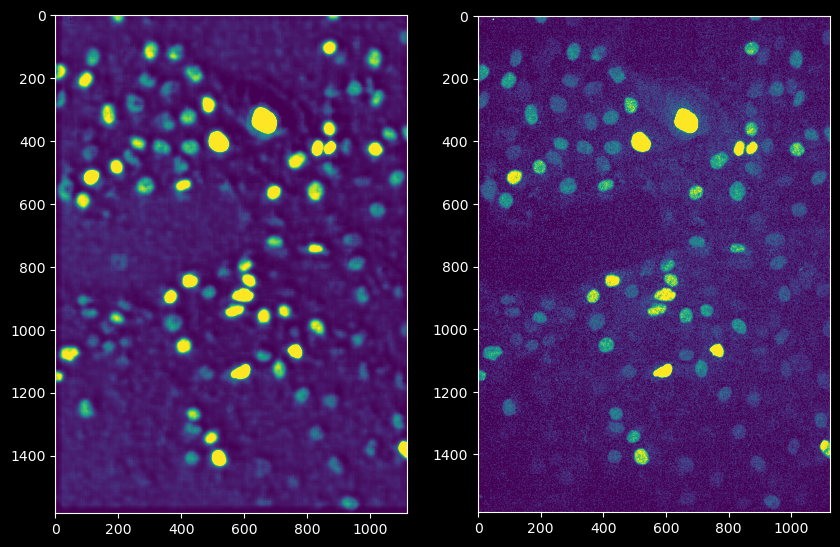

In [134]:
fig, axes=plt.subplots(1,2,figsize=(10,7))
axes[0].imshow(X[3], vmin=0.7, vmax=1)
axes[1].imshow(prediction[3], vmin=0.06, vmax=0.8)

In [78]:
prediction[0].shape

(1584, 1120, 1)

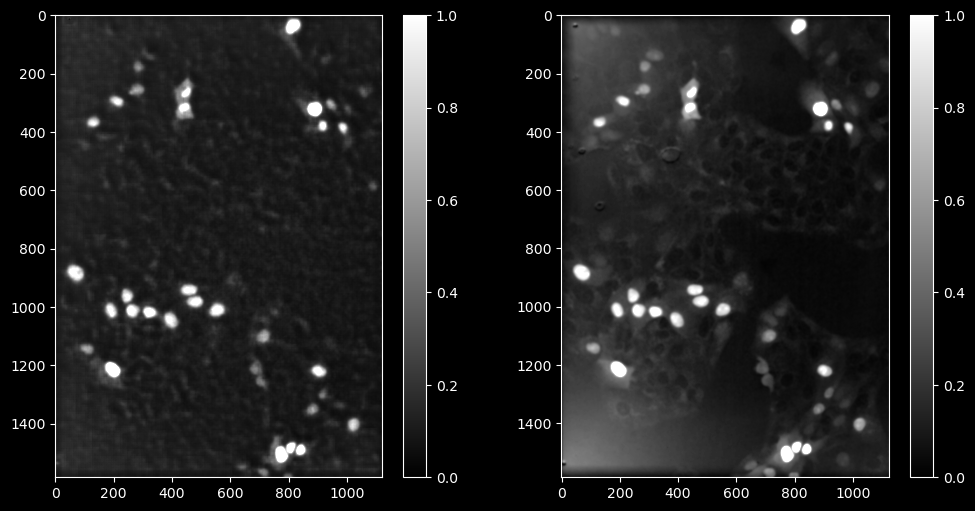

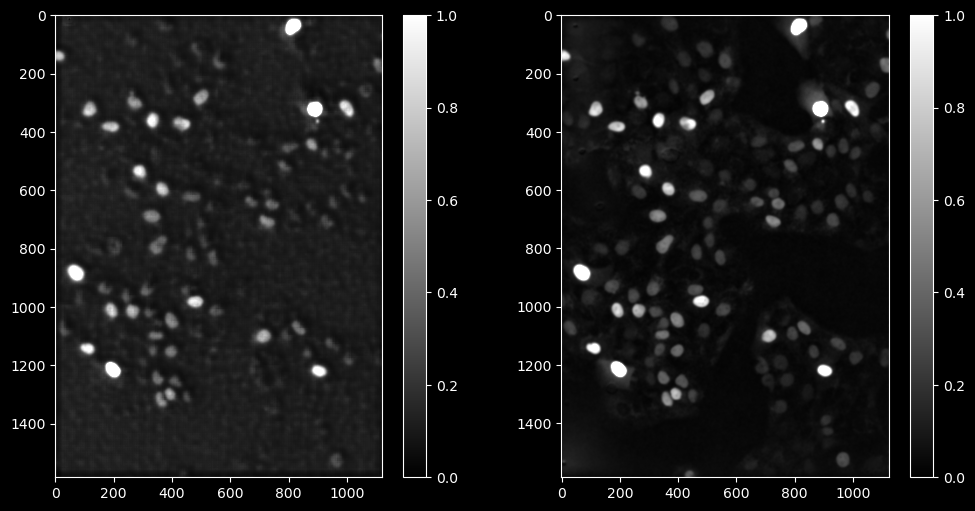

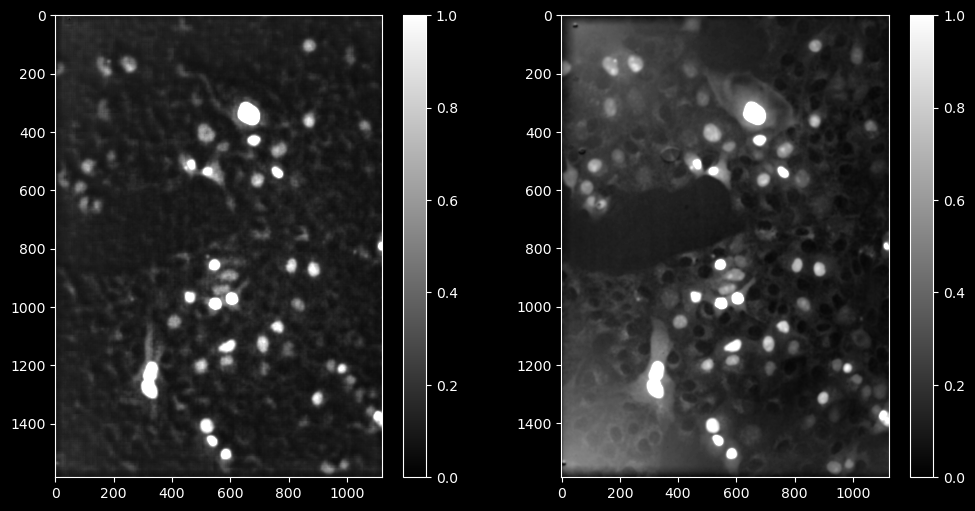

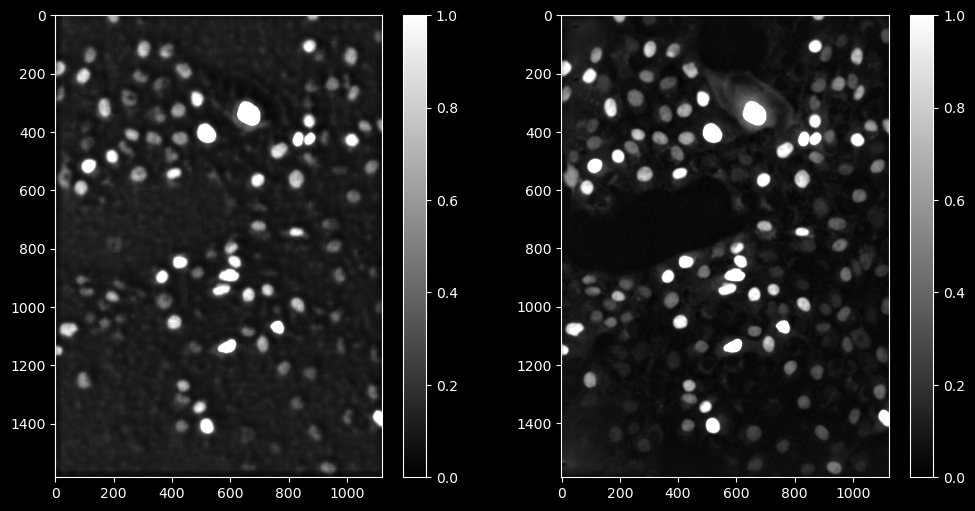

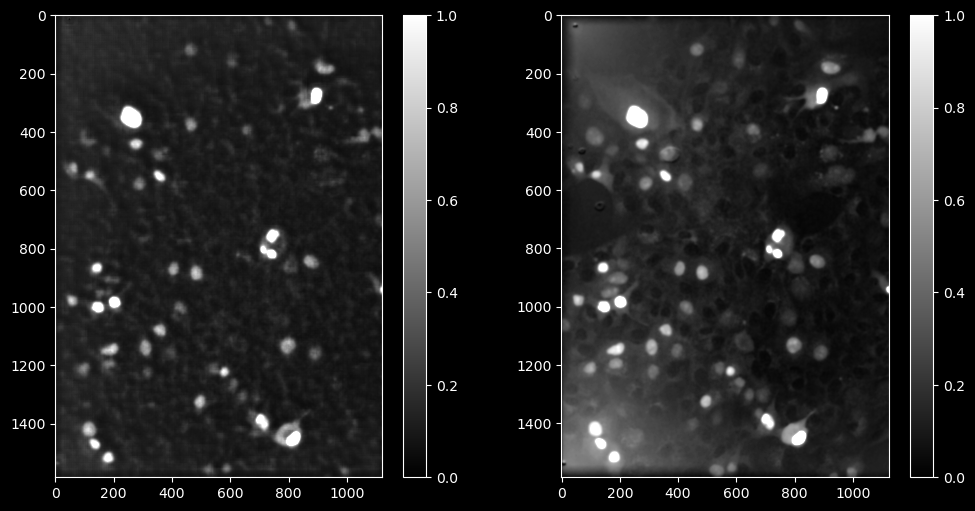

...

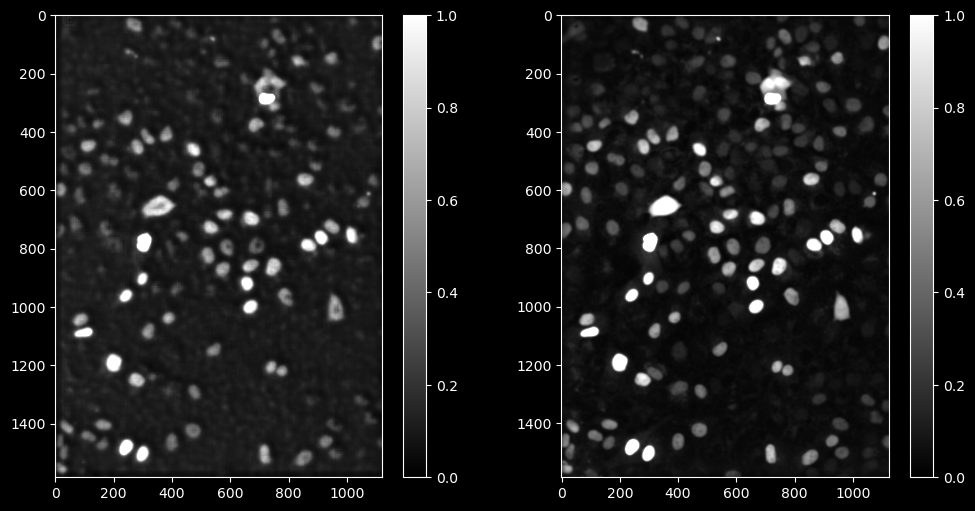

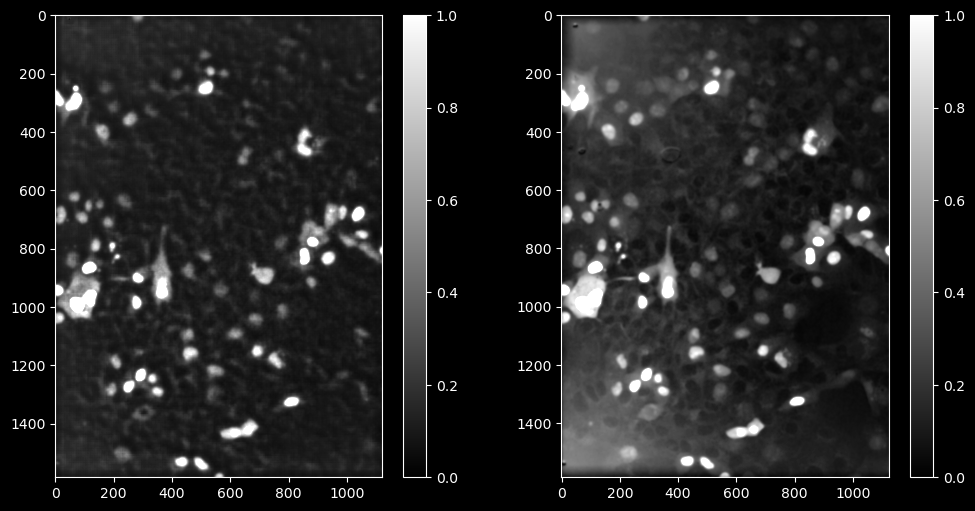

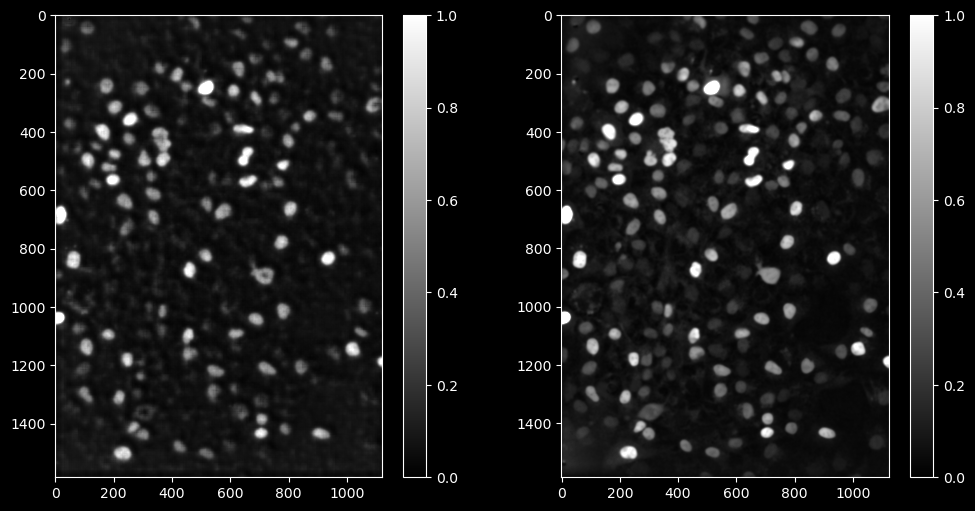

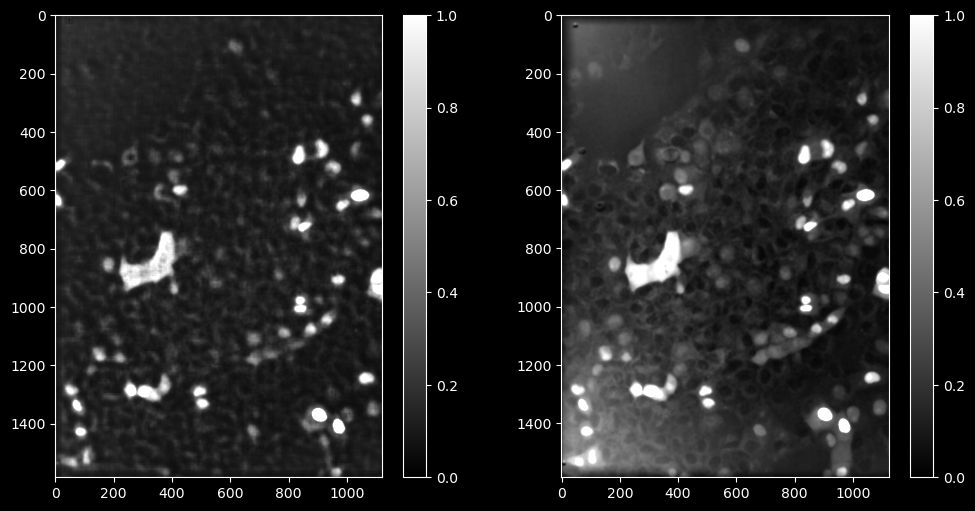

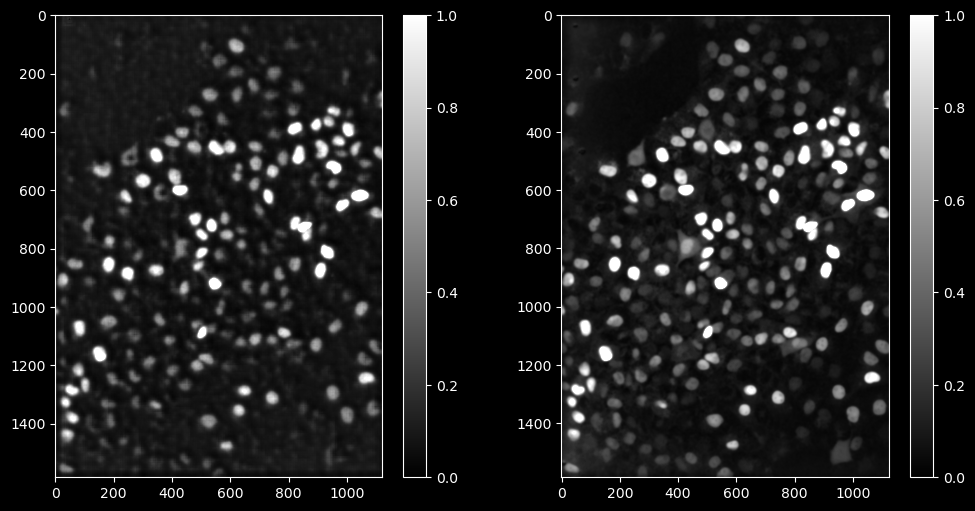

In [75]:
for predicted_img, true_img in zip(prediction, y[:20]):
    fig, axes=plt.subplots(1,2, figsize=(12,6))
    cbar=axes[0].imshow(predicted_img.squeeze(), vmin=0, vmax=1, cmap='gray')
    plt.colorbar(cbar, ax=axes[0])
    cbar=axes[1].imshow(true_img, vmin=0, vmax=1, cmap='gray')
    plt.colorbar(cbar, ax=axes[1])
    plt.show()

In [71]:
prediction=[]
input=[]
tile_size=256

for img in tqdm(X[:20]):
    tiles_X=get_tiles(img, tile_size)[...,np.newaxis]
    input.append(img)
    predicted_tiles=model.predict(tiles_X, batch_size=1, verbose=0)[...,0]
    stitched_prediction=stitch_tiles(predicted_tiles, img.shape)
    prediction.append(stitched_prediction)

prediction=np.array(prediction)
input=np.array(input)

  0%|          | 0/20 [00:00<?, ?it/s]

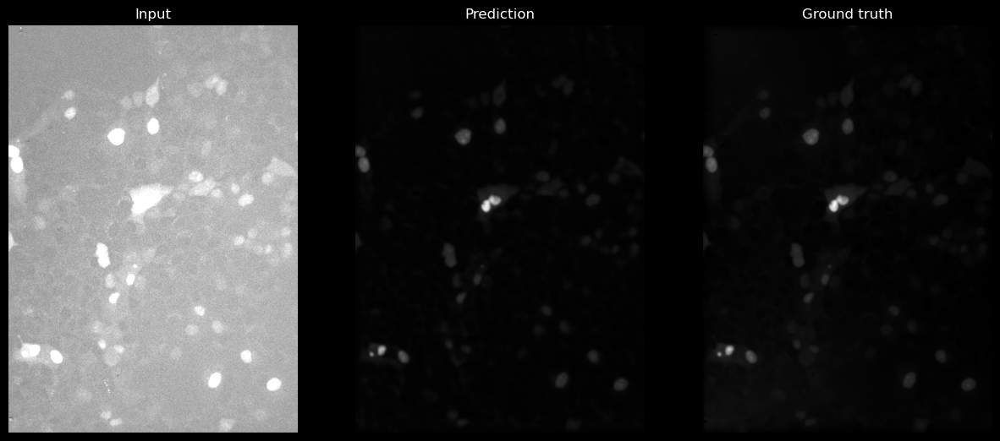

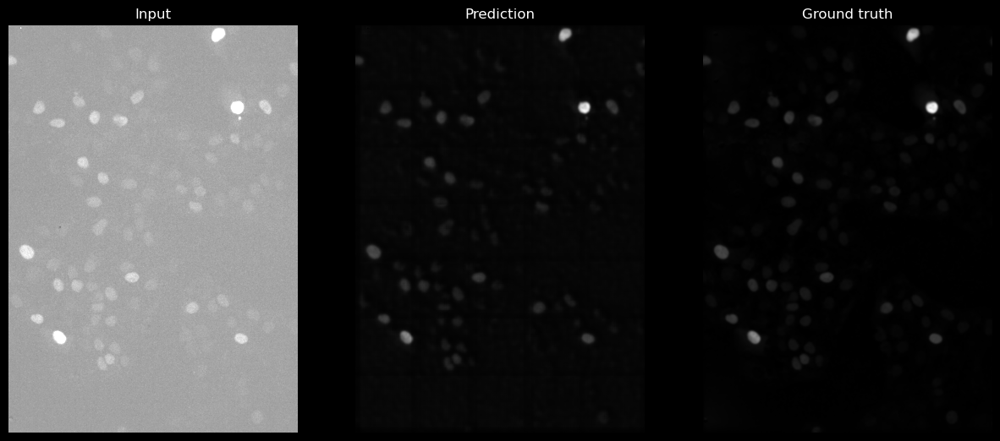

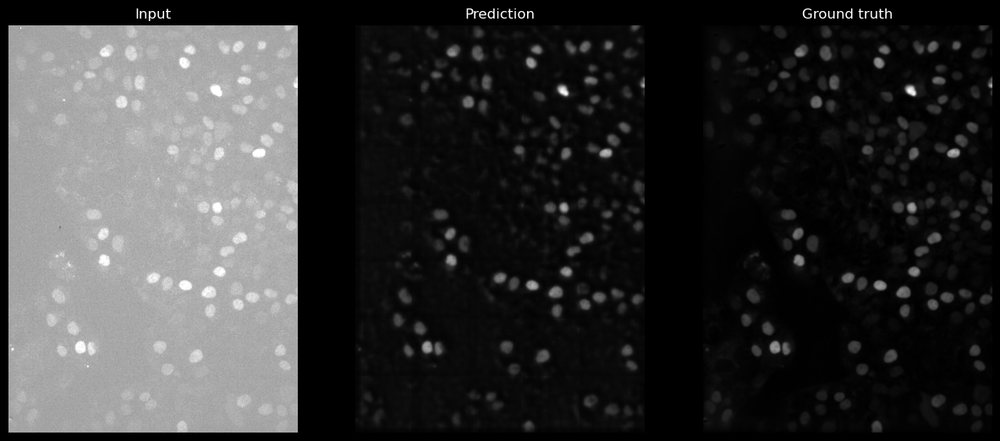

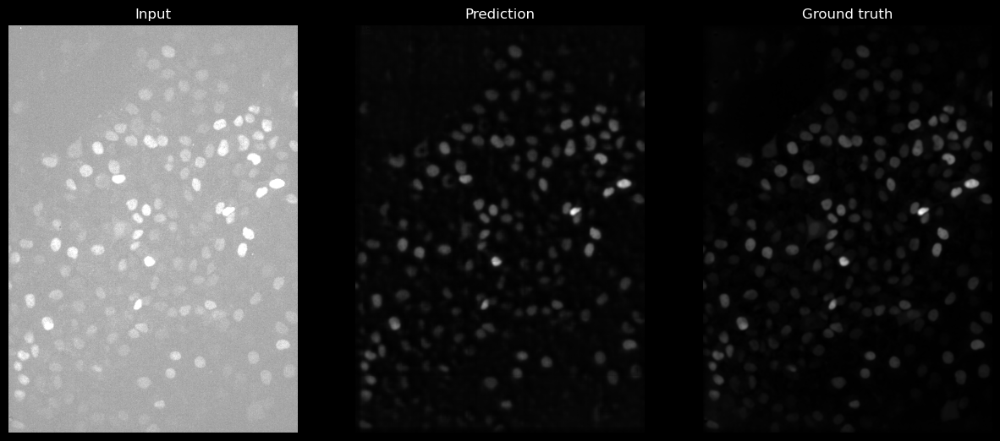

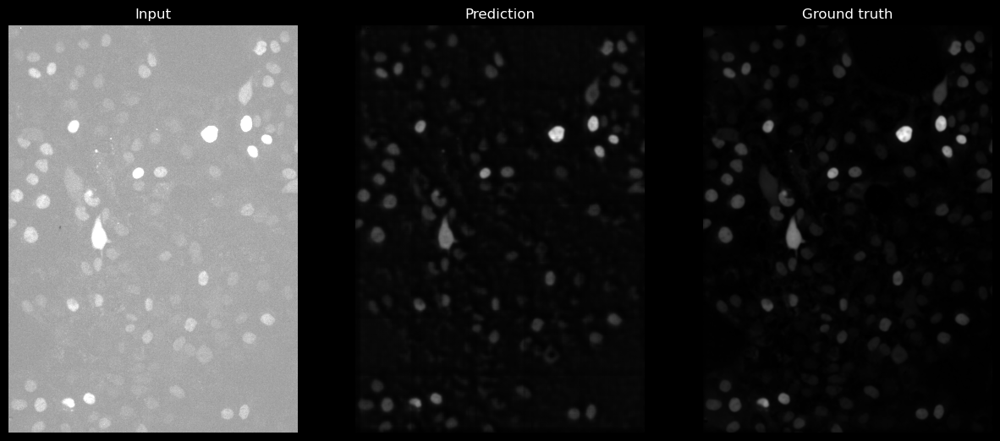

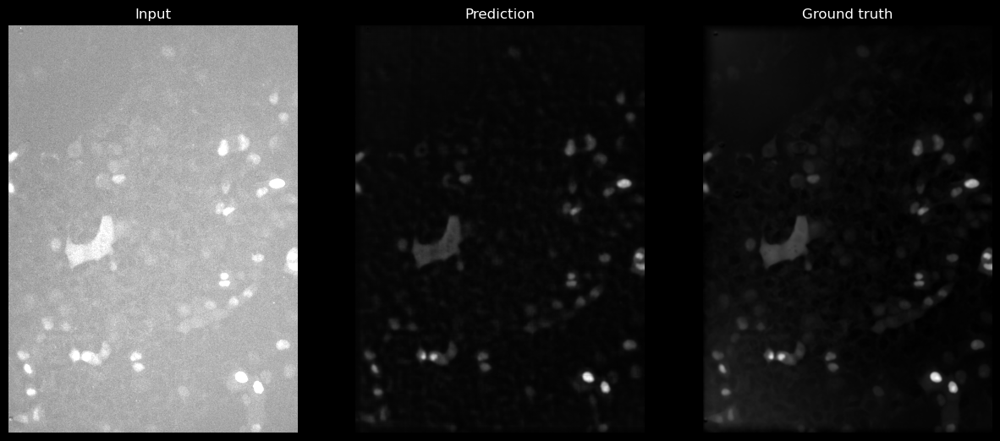

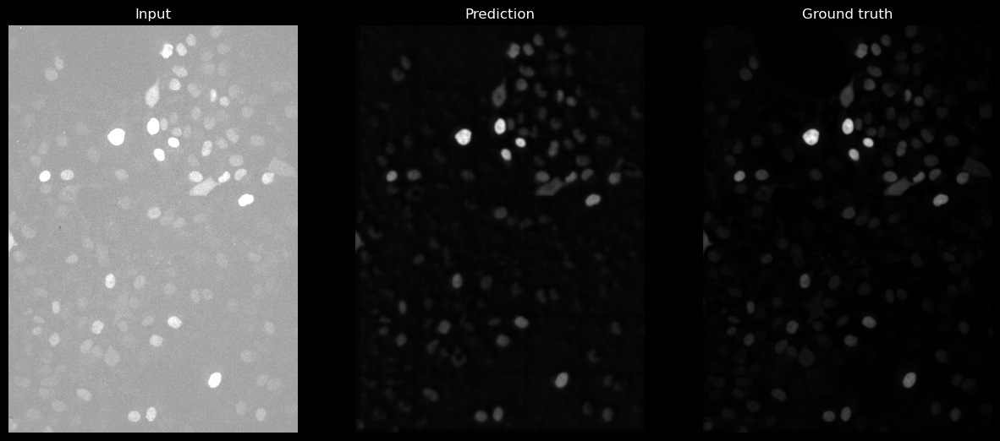

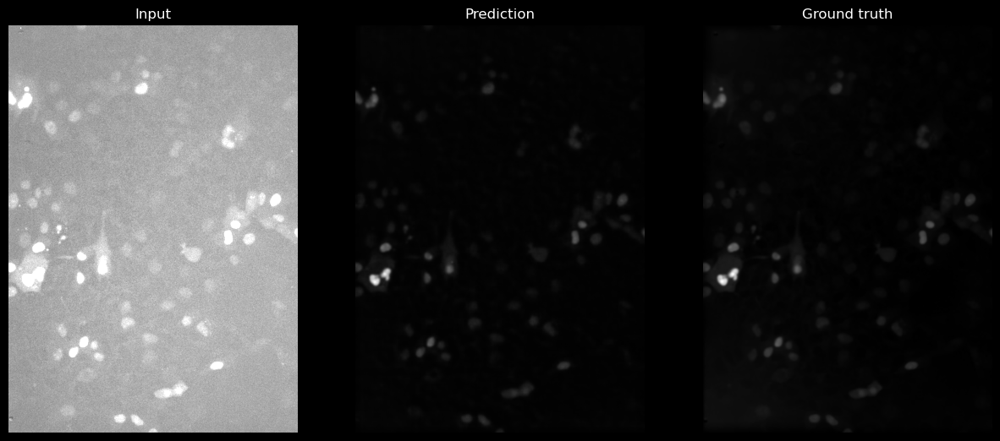

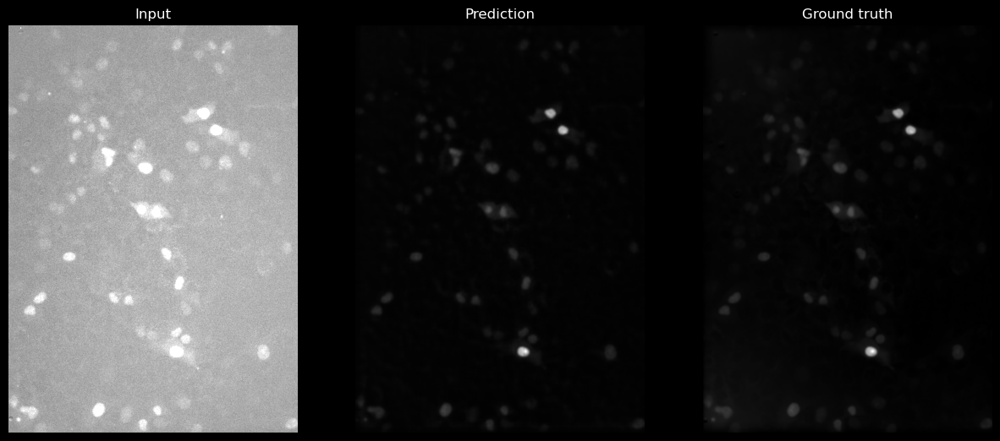

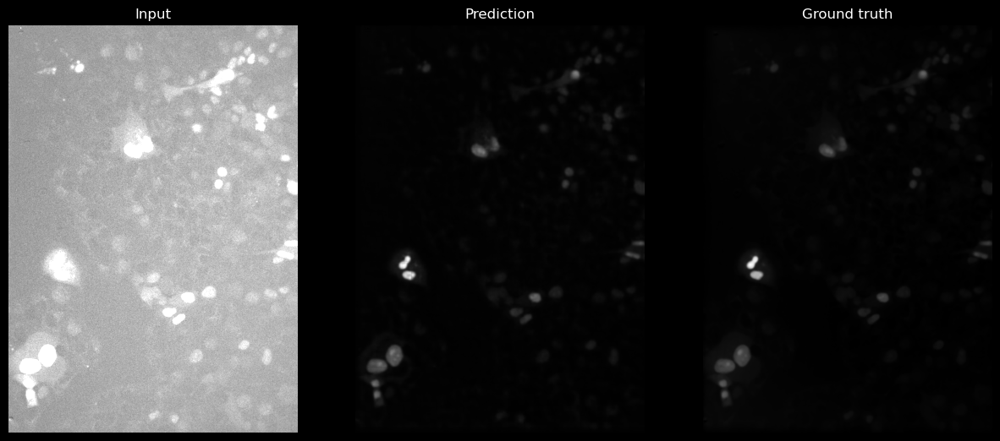

In [72]:
random_indices=np.random.choice(np.arange(len(prediction)), size=10, replace=False)
plt.style.use('dark_background')
for index in random_indices:
    fig, axes=plt.subplots(1,3, figsize=(15,7))
    axes[0].imshow(input[index], cmap='gray', vmin=0.2, vmax=1)
    axes[0].set_title('Input')
    axes[1].imshow(prediction[index], cmap='gray')
    axes[1].set_title('Prediction')
    axes[2].imshow(y[index], cmap='gray')
    axes[2].set_title('Ground truth')
    for ax in axes:
        ax.axis('off')
    plt.show()